<a href="https://colab.research.google.com/github/safitrisoetam/DefleksiMembranPEMODB/blob/main/DefleksiMembrane.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Model Matematika Getaran Membran Berbentuk Empat Persegi Panjang**


<font size=3>**Auliyah Safitri Soetam Putri**
</br>**06111840000042**
</br>**Pemodelan Matematika (C)**

##Desain program komputer untuk mencari solusi dari defleksi membrane [U(x,y,t)]

**Langkah 1**
<br/> Import library dan packages yang akan digunakan


In [14]:
#Numpy untuk perhitungan
import numpy as np
#Pi,Sin,Cos,dan Pangkat kuadrat untuk memudahkan perhitungan
from numpy import pi,sin,cos,sqrt
#Matplotlib untuk plotting
import matplotlib.pyplot as plt
#Axes3D untuk grafik 3 dimensi
from mpl_toolkits.mplot3d import axes3d
#Animation untuk menganimasikan
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

**Langkah 2**
</br>Menyiapkan Grafik 3 Dimensi

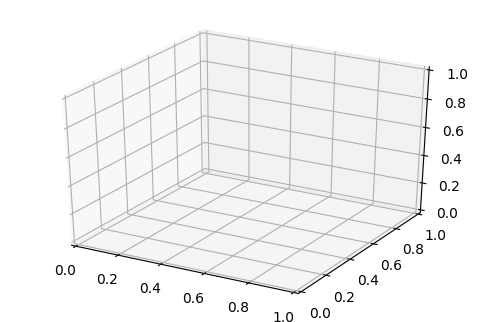

In [15]:
fig = plt.figure()
fig.set_dpi(100)
ax1 = fig.gca(projection='3d')

**Langkah 3**
</br>Membuat dua array, masing-masing satu dimensi dengan nilai dalam interval 0 hingga 1 yang memiliki panjang sebanyak 30 elemen

In [16]:
x = np.linspace(0,1,30)
print(x)
print('Array x adalah 1 Dimensi dengan panjang {} elemen'.format(x.shape))

[0.         0.03448276 0.06896552 0.10344828 0.13793103 0.17241379
 0.20689655 0.24137931 0.27586207 0.31034483 0.34482759 0.37931034
 0.4137931  0.44827586 0.48275862 0.51724138 0.55172414 0.5862069
 0.62068966 0.65517241 0.68965517 0.72413793 0.75862069 0.79310345
 0.82758621 0.86206897 0.89655172 0.93103448 0.96551724 1.        ]
Array x adalah 1 Dimensi dengan panjang (30,) elemen


In [17]:
y = np.linspace(0,1,30)
print(y)
print('Array y adalah 1 Dimensi dengan panjang {} elemen'.format(y.shape))

[0.         0.03448276 0.06896552 0.10344828 0.13793103 0.17241379
 0.20689655 0.24137931 0.27586207 0.31034483 0.34482759 0.37931034
 0.4137931  0.44827586 0.48275862 0.51724138 0.55172414 0.5862069
 0.62068966 0.65517241 0.68965517 0.72413793 0.75862069 0.79310345
 0.82758621 0.86206897 0.89655172 0.93103448 0.96551724 1.        ]
Array y adalah 1 Dimensi dengan panjang (30,) elemen


In [18]:
X,Y = np.meshgrid(x,y)

**Langkah 3**
<br/>Melakukan inisiasi parameter

In [19]:
#Kecepatan gelombang
c = 1
#Waktu awal
t0 = 0
#Pertambahan waktu
dt = 0.03
#Membangun persamaan
p = 2
q = 3
w = pi*c*sqrt(p**2+q**2)
print(w)

11.327173399138976


**Langkah 4**
<br/>Melakukan inisiasi fungsi gelombang

In [20]:
#Persamaan
def u(x,y,t):
    return (cos(w*t)+sin(w*t))*sin(pi*p*x)*sin(q*pi*y)

**Langkah 5**
</br>Melakukan iterasi untuk setiap elemen pada array satu dimensi

In [21]:
#Menentukan titik pada elemen
a = []
for i in range(500):
    z = u(X,Y,t0)
    t0 = t0 + dt
    a.append(z)
print('List a memiliki panjang {} elemen'.format(len(a)))
print('Menampilkan elemen pertama :')
print(a[0])

List a memiliki panjang 500 elemen
Menampilkan elemen pertama :
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00]
 [ 0.00000000e+00  6.86403905e-02  1.34071233e-01  1.93233053e-01
   2.43359510e-01  2.82106748e-01  3.07662987e-01  3.18833247e-01
   3.15095219e-01  2.96623688e-01  2.64282364e-01  2.19583489e-01
   1.64617135e-01  1.01953467e-01  3.45225680e-02 -3.45225680e-02
  -1.01953467e-01 -1.64617135e-01 -2.19583489e-01 -2.64282364e-01
  -2.96623688e-01 -3.15095219e-01 -3.18833247e-01 -3.07662987e-01
  -2.82106748e-01 -2.43359510e-01 -1.932330

**Langkah 6**
<br/>Melakukan Plotting pada Grafik yang telah disiapkan

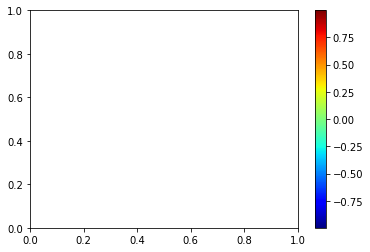

In [22]:
#Membuat skala warna 
m = plt.cm.ScalarMappable(cmap=plt.cm.jet)
m.set_array(a[0])
cbar = plt.colorbar(m)

In [23]:
#Membuat fungsi untuk animasi
k = 0
def animate(i):
    global k
    Z = a[k]
    k += 1
    ax1.clear()
    ax1.plot_surface(X,Y,Z,rstride=1, cstride=1,cmap=plt.cm.jet,linewidth=0,antialiased=False)
    ax1.contour(X,Y,Z)
    ax1.set_zlim(0,5)
anim = animation.FuncAnimation(fig,animate,frames=220,interval=20)
plt.show()

#Simulasi

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


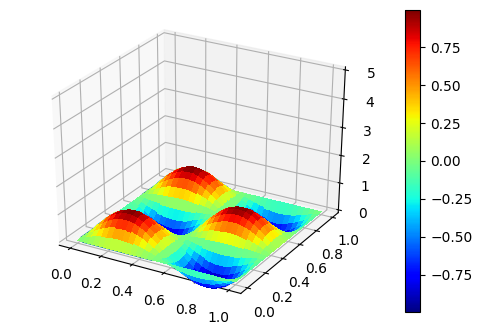

In [24]:
#Numpy untuk perhitungan
import numpy as np
#Pi,Sin,Cos,dan Pangkat kuadrat untuk memudahkan perhitungan
from numpy import pi,sin,cos,sqrt
#Matplotlib untuk plotting
import matplotlib.pyplot as plt
#Axes3D untuk grafik 3 dimensi
from mpl_toolkits.mplot3d import axes3d
#Animation untuk menganimasikan
import matplotlib.animation as animation

#Melakukan plotting
fig = plt.figure()
fig.set_dpi(100)
ax1 = fig.gca(projection='3d')

#Inisiasi Array 1 Dimensi
x = np.linspace(0,1,30)
y = np.linspace(0,1,30)

X,Y = np.meshgrid(x,y)

#Inisiasi Parameter
#Kecepatan Gelombang
c = 1
#Waktu awal
t0 = 0
#Pertambahan Waktu
dt = 0.03
#Perhitungan Persamaan
p = 2 #1 #5 #2 #5
q = 3 #1 #5 #3 #3
w = pi*c*sqrt(p**2+q**2)

#Inisiasi Fungsi Persamaan Gelombang
def u(x,y,t):
    return (cos(w*t)+sin(w*t))*sin(pi*p*x)*sin(q*pi*y)

#Iterasi pada setiap elemen pada array yang telah dibuat
a = []
for i in range(500):
    z = u(X,Y,t0)
    t0 = t0 + dt
    a.append(z)

#Menambahkan Skala Warna
m = plt.cm.ScalarMappable(cmap=plt.cm.jet)
m.set_array(a[0])
cbar = plt.colorbar(m)

#Inisiasi Fungsi animasi
k = 0
def animate(i):
    global k
    Z = a[k]
    k += 1
    ax1.clear()
    ax1.plot_surface(X,Y,Z,rstride=1, cstride=1,cmap=plt.cm.jet,linewidth=0,antialiased=False)
    ax1.contour(X,Y,Z)
    ax1.set_zlim(0,5)
    
anim = animation.FuncAnimation(fig,animate,frames=220,interval=20)
plt.show()

In [25]:
anim

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [26]:
anim.save('DefleksiMembrane.gif', writer = "pillow", fps=10 )

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)
